In [1]:
import os
from glob import glob
import numpy as np
import dask
import xarray as xr
import cartopy.crs as ccrs
from cmocean import cm
import xgcm

from matplotlib import pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = 12, 8

from mitequinox.utils import *

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/site-packages/cmocean/tools.py:76: MatplotlibDeprecationWarning: The is_string_like function was deprecated in version 2.1.
  if not mpl.cbook.is_string_like(rgbin[0]):


In [2]:
from dask_jobqueue import PBSCluster
local_dir = os.getenv('TMPDIR')
cluster = PBSCluster(local_directory=local_dir)
#print(cluster.job_script())
w = cluster.start_workers(30)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/site-packages/distributed/utils.py:128: RuntimeWarning: Couldn't detect a suitable IP address for reaching '8.8.8.8', defaulting to '127.0.0.1': [Errno 101] Network is unreachable
  % (host, default, e), RuntimeWarning)


In [3]:
# get dask handles and check dask server status
from dask.distributed import Client
client = Client(cluster)

In [5]:
client

Client Scheduler: tcp://10.148.1.0:46778 Dashboard: http://10.148.1.0:8787/status,Cluster Workers: 60 Cores: 240 Memory: 3000.00 GB


_________
# Read dataset


In [6]:
Nf = 1
data_dir = '/home1/scratch/xyu/mit_nc_t/'

filenames_SSU = sorted(glob(data_dir+'SSU_*.nc'))
filenames_SSU = filenames_SSU[:Nf]
ds_SSU = xr.open_mfdataset(filenames_SSU, concat_dim='time', compat='equals')

filenames_SSV = sorted(glob(data_dir+'SSV_*.nc'))
filenames_SSV = filenames_SSV[:Nf]
ds_SSV = xr.open_mfdataset(filenames_SSV, concat_dim='time', compat='equals')

grid = xr.open_dataset('/home1/scratch/xyu/mit_grid.nc', decode_coords=True)


In [7]:
ds = xr.merge([ds_SSU, ds_SSV, grid])
print(ds)

<xarray.Dataset>
Dimensions:  (face: 13, i: 4320, i_g: 4320, j: 4320, j_g: 4320, time: 1)
Coordinates:
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * time     (time) float64 5.702e+06
    dtime    (time) datetime64[ns] dask.array<shape=(1,), chunksize=(1,)>
  * i_g      (i_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
  * j_g      (j_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
    XC       (face, j, i) float32 ...
    YC       (face, j, i) float32 ...
    XG       (face, j_g, i_g) float32 ...
    YG       (face, j_g, i_g) float32 ...
    rA       (face, j, i) float32 ...
    dxG      (face, j_g, i) float32 ...
    dyG      (face, j, i_g) float32 ...
    Depth    (face, j, i) float32 ...
    rAz      (face, j_g, i_g) float32 ...
    dxC      (face, j, i_g) float32 ...
    dyC      (

In [8]:
def quick_llc_plot(data, axis_off=False, **kwargs):
    face_to_axis = {0: (2, 0), 1: (1, 0), 2: (0, 0),
                    3: (2, 1), 4: (1, 1), 5: (0, 1),
                    7: (0, 2), 8: (1, 2), 9: (2, 2),
                    10: (0, 3), 11: (1, 3), 12: (2, 3)}
    transpose = [7, 8, 9, 10, 11, 12]
    gridspec_kw = dict(left=0, bottom=0, right=4, top=4, wspace=0, hspace=0)
    fig, axes = plt.subplots(nrows=3, ncols=4, gridspec_kw=gridspec_kw)
    for face, (j, i) in face_to_axis.items():
        data_ax = data.isel(face=face)
        ax = axes[j,i]
        yincrease = True
        if face in transpose:
            data_ax = data_ax.transpose()
            yincrease = False
        data_ax.plot(ax=ax, yincrease=yincrease, **kwargs)
        if axis_off:
            ax.axis('off')
        ax.set_title('')

---


In [9]:
#import xgcm
grid = xgcm.Grid(ds, periodic=['X', 'Y'])
grid

<xgcm.Grid>
X Axis (periodic):
  * center   i (4320) --> left
  * left     i_g (4320) --> center
Y Axis (periodic):
  * center   j (4320) --> left
  * left     j_g (4320) --> center

distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.0:33955 remote=tcp://10.148.1.0:46778>
distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.0:33957 remote=tcp://10.148.1.0:46778>
distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.0:33958 remote=tcp://10.148.1.0:46778>
distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.0:33959 remote=tcp://10.148.1.0:46778>


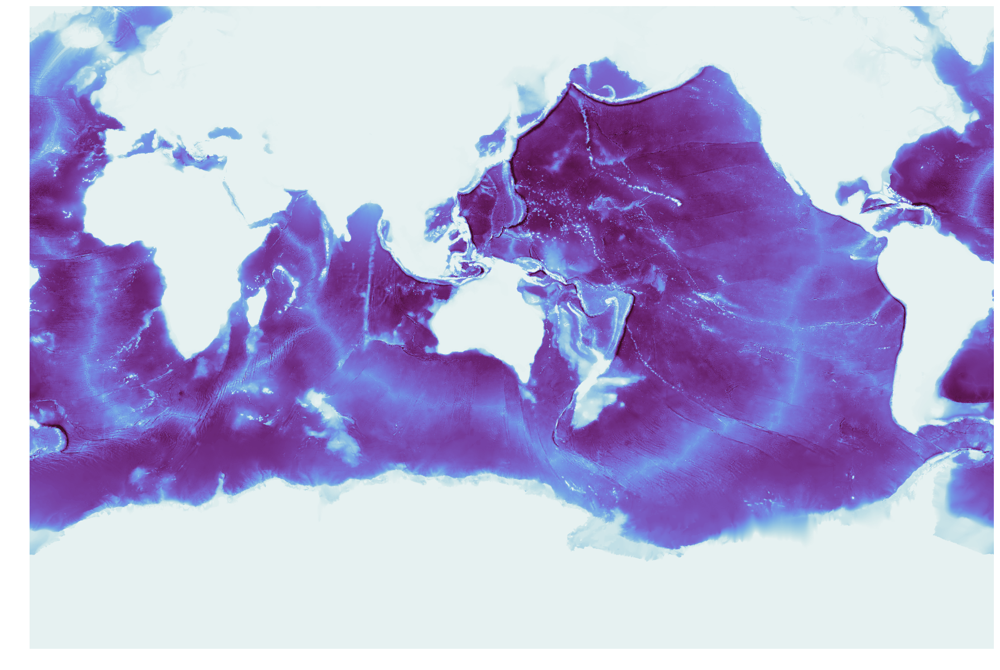

In [10]:
quick_llc_plot(ds.Depth, vmin=0, vmax=7000, add_colorbar=False, axis_off=True, cmap = cm.dense)


# Horizontal divergence

In [19]:
SSV_dxG = ds.dxG * ds['SSV']
SSU_dyG = ds.dyG * ds['SSU']

In [22]:
vel_div_components = grid.diff_2d_vector({'X': SSU_dyG, 'Y': SSV_dxG}, boundary='fill')
print(vel_div_components)

{'X': <xarray.DataArray 'sub-2b2f34fb14a082b4a49d0ca358ac942f' (face: 13, j: 4320, i: 4320, time: 4)>
dask.array<shape=(13, 4320, 4320, 4), dtype=float32, chunksize=(13, 4320, 4319, 1)>
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * time     (time) float64 5.702e+06 5.706e+06 5.71e+06 5.713e+06, 'Y': <xarray.DataArray 'sub-e37bdf52625bf7b634dbb201c45bf894' (face: 13, j: 4320, i: 4320, time: 4)>
dask.array<shape=(13, 4320, 4320, 4), dtype=float32, chunksize=(13, 4319, 4320, 1)>
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * time     (time) float64 5.702e+06 5.706e+06 5.71e+06 5.713e+06}


In [23]:
vel_div = vel_div_components['X'] + vel_div_components['Y']
vel_div

<xarray.DataArray (face: 13, j: 4320, i: 4320, time: 4)>
dask.array<shape=(13, 4320, 4320, 4), dtype=float32, chunksize=(13, 4319, 4319, 1)>
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * time     (time) float64 5.702e+06 5.706e+06 5.71e+06 5.713e+06

In [24]:
vel_div_load = vel_div.isel(time=0).load()

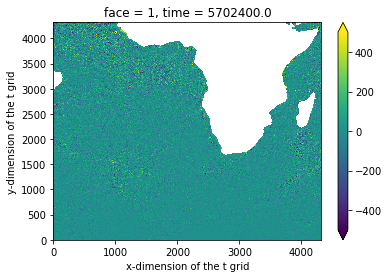

In [28]:
vel_div_load.isel(face=1).plot(vmin = -500, vmax = 500)

distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.0.107:45443 remote=tcp://10.148.0.107:56253>


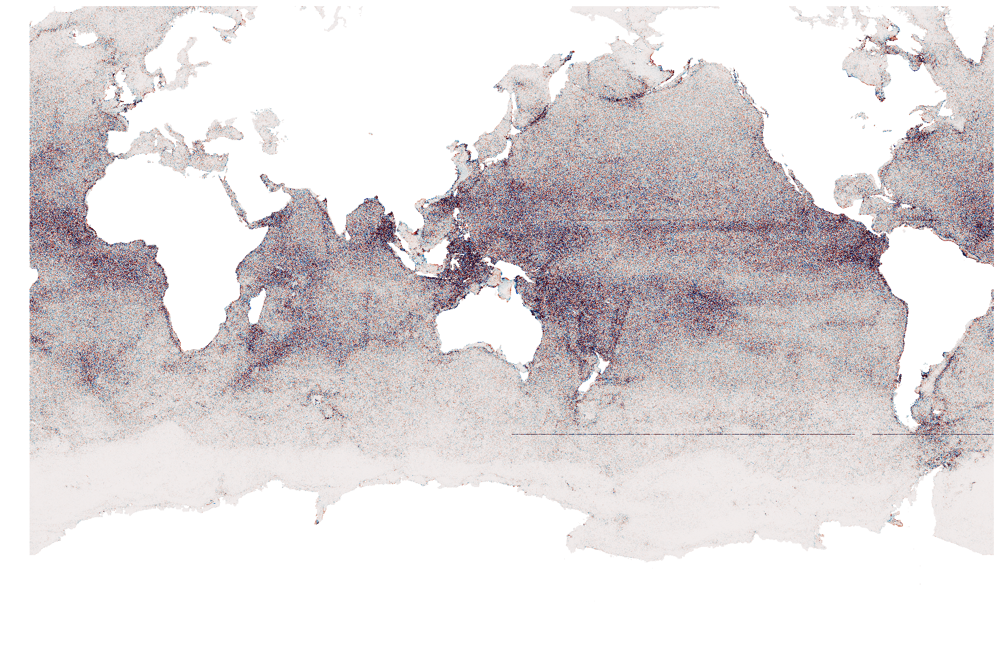

In [29]:
quick_llc_plot(vel_div_load, vmin = -200, vmax=200, add_colorbar=False, axis_off=True, cmap = cm.balance)


In [35]:
zeta_3_time0 = zeta_3.isel(time=0)
print(zeta_3_time0)

<xarray.DataArray (face: 13, j_g: 4320, i_g: 4320)>
dask.array<shape=(13, 4320, 4320), dtype=float32, chunksize=(13, 1, 1)>
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j_g      (j_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
  * i_g      (i_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
    time     float64 5.702e+06
    XG       (face, j_g, i_g) float32 ...
    YG       (face, j_g, i_g) float32 ...
    rAz      (face, j_g, i_g) float32 ...


In [36]:
Rossby_number_time0 = zeta_3_time0/f
print(Rossby_number_time0)

<xarray.DataArray (face: 13, j_g: 4320, i_g: 4320)>
dask.array<shape=(13, 4320, 4320), dtype=float32, chunksize=(13, 1, 1)>
Coordinates:
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j_g      (j_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
  * i_g      (i_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
    time     float64 5.702e+06
    XG       (face, j_g, i_g) float32 -115.0 -115.0 -115.0 -115.0 -115.0 ...
    YG       (face, j_g, i_g) float32 -88.17569 -88.17861 -88.181526 ...
    rAz      (face, j_g, i_g) float32 77743.875 77748.9 77753.945 77759.03 ...


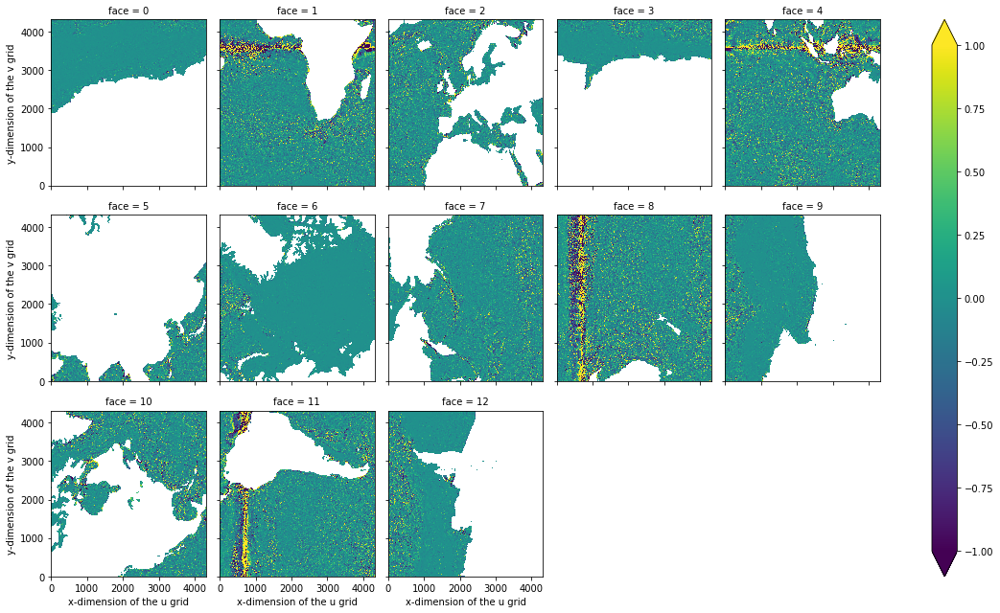

In [37]:
Rossby_number_time0.plot(col='face', col_wrap=5, vmin=-1., vmax=1.)

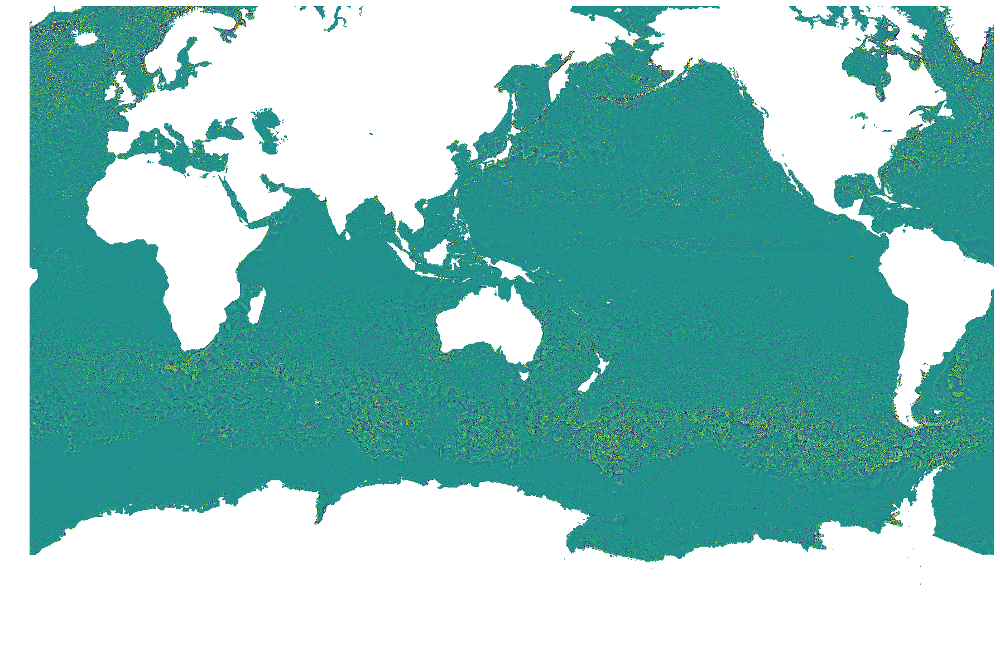

In [38]:
quick_llc_plot(zeta_3_time0, vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True)

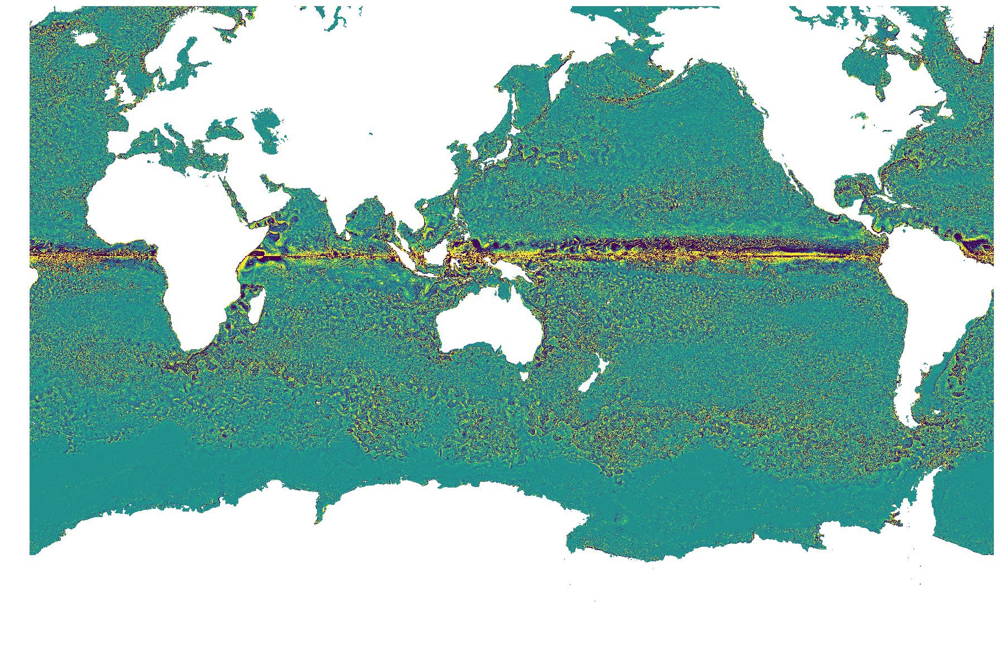

In [53]:
quick_llc_plot(Rossby_number_time0, vmin=-0.5, vmax=0.5, add_colorbar=False, axis_off=True)

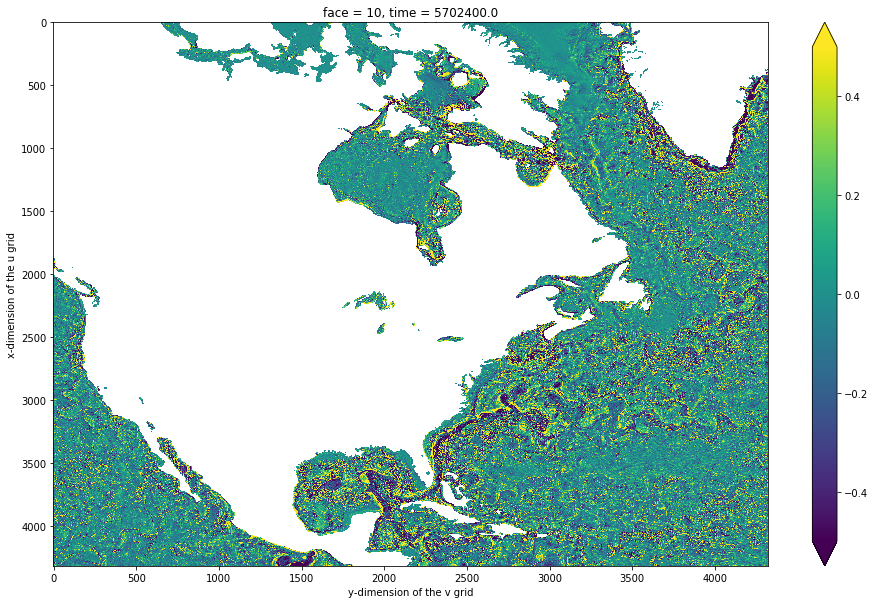

In [41]:
fig = plt.figure(figsize=(16,10))

Rossby_number_time0_t = Rossby_number_time0.isel(face=10).transpose()
Rossby_number_time0_t.plot(vmin=-0.5, vmax=0.5, yincrease=False)

# 4. KE

In [42]:
SSU_2 = ds['SSU'] * ds['SSU']
SSU_2_i = grid.interp(SSU_2,'X')
print(SSU_2_i)

<xarray.DataArray 'mul-d86586bd7cc5332c84553b709210889c' (time: 2, face: 13, j: 4320, i: 4320)>
dask.array<shape=(2, 13, 4320, 4320), dtype=float32, chunksize=(1, 13, 4320, 4319)>
Coordinates:
  * time     (time) float64 5.702e+06 5.706e+06
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...


In [43]:
SSV_2 = ds['SSV'] * ds['SSV']
SSV_2_j = grid.interp(SSV_2,'Y')
print(SSV_2_j)

<xarray.DataArray 'mul-3a2ae2ad4cd1b7eb0fd229ef80ec4d10' (time: 2, face: 13, j: 4320, i: 4320)>
dask.array<shape=(2, 13, 4320, 4320), dtype=float32, chunksize=(1, 13, 4319, 4320)>
Coordinates:
  * time     (time) float64 5.702e+06 5.706e+06
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...


In [44]:
KE = (SSU_2_i + SSV_2_j)/2
print(KE)

<xarray.DataArray (time: 2, face: 13, j: 4320, i: 4320)>
dask.array<shape=(2, 13, 4320, 4320), dtype=float32, chunksize=(1, 13, 4319, 4319)>
Coordinates:
  * time     (time) float64 5.702e+06 5.706e+06
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...


In [45]:
KE_time0 = KE.isel(time=0)

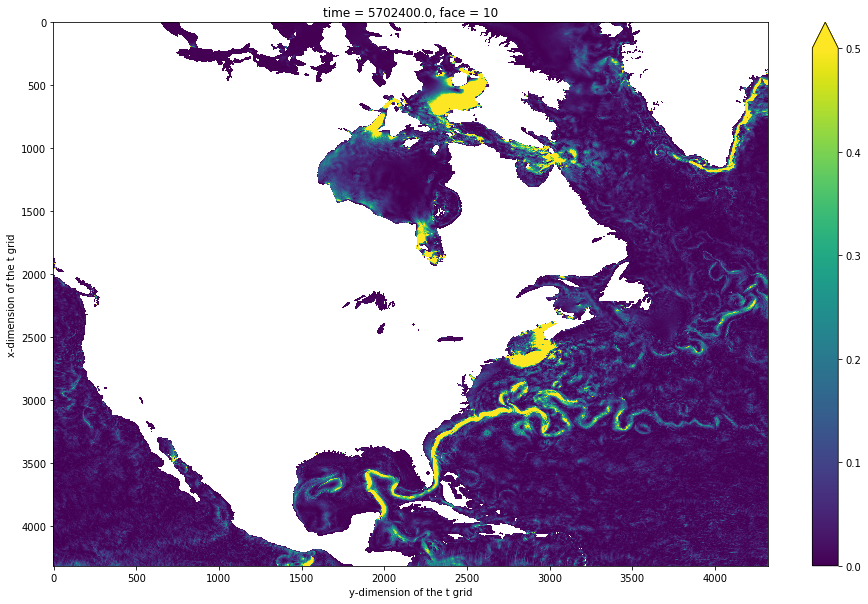

In [46]:
fig = plt.figure(figsize=(16,10))

KE_time0_t = KE_time0.isel(face=10).transpose()
KE_time0_t.plot(vmin=0., vmax=0.5, yincrease=False)

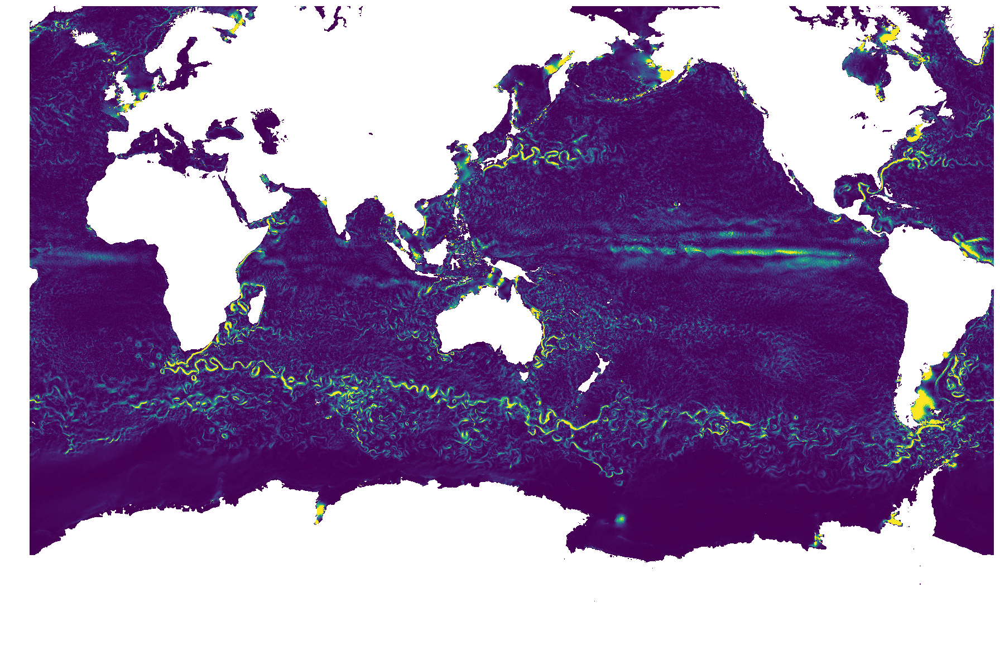

In [47]:
quick_llc_plot(KE_time0, vmin=0, vmax=0.5, add_colorbar=False, axis_off=True)

# 5 Horizontal divergence

In [56]:
print(ds)

<xarray.Dataset>
Dimensions:  (face: 13, i: 4320, i_g: 4320, j: 4320, j_g: 4320, time: 2)
Coordinates:
  * i_g      (i_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * time     (time) float64 5.702e+06 5.706e+06
    dtime    (time) datetime64[ns] dask.array<shape=(2,), chunksize=(1,)>
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * j_g      (j_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 ...
    XC       (face, j, i) float32 ...
    YC       (face, j, i) float32 ...
    XG       (face, j_g, i_g) float32 ...
    YG       (face, j_g, i_g) float32 ...
    rA       (face, j, i) float32 ...
    dxG      (face, j_g, i) float32 ...
    dyG      (face, j, i_g) float32 ...
    Depth    (face, j, i) float32 ...
    rAz      (face, j_g, i_g) float32 ...
    dxC      (face, j, i_g) float32 ...
    

In [57]:
d_SSU_dyG_di = grid.diff(ds['SSU']*ds.dyG,'X')
print(d_SSU_dyG_di)

<xarray.DataArray 'sub-ce45549e50745517c6e2c3aad597a643' (time: 2, face: 13, j: 4320, i: 4320)>
dask.array<shape=(2, 13, 4320, 4320), dtype=float32, chunksize=(1, 13, 4320, 4319)>
Coordinates:
  * time     (time) float64 5.702e+06 5.706e+06
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...


In [58]:
d_SSV_dxG_dj = grid.diff(ds['SSV']*ds.dxG,'Y')
print(d_SSV_dxG_dj)

<xarray.DataArray 'sub-0a9d34c05c94ded7601f2de792c6b35c' (time: 2, face: 13, j: 4320, i: 4320)>
dask.array<shape=(2, 13, 4320, 4320), dtype=float32, chunksize=(1, 13, 4319, 4320)>
Coordinates:
  * time     (time) float64 5.702e+06 5.706e+06
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...


In [59]:
divergence = (d_SSU_dyG_di + d_SSV_dxG_dj)/ds.rA
print(divergence)

<xarray.DataArray (time: 2, face: 13, j: 4320, i: 4320)>
dask.array<shape=(2, 13, 4320, 4320), dtype=float32, chunksize=(1, 13, 4319, 4319)>
Coordinates:
  * time     (time) float64 5.702e+06 5.706e+06
  * face     (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
  * j        (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
  * i        (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 ...
    XC       (face, j, i) float32 ...
    YC       (face, j, i) float32 ...
    rA       (face, j, i) float32 ...
    Depth    (face, j, i) float32 ...


In [60]:
divergence_time0 = divergence.isel(time=0)

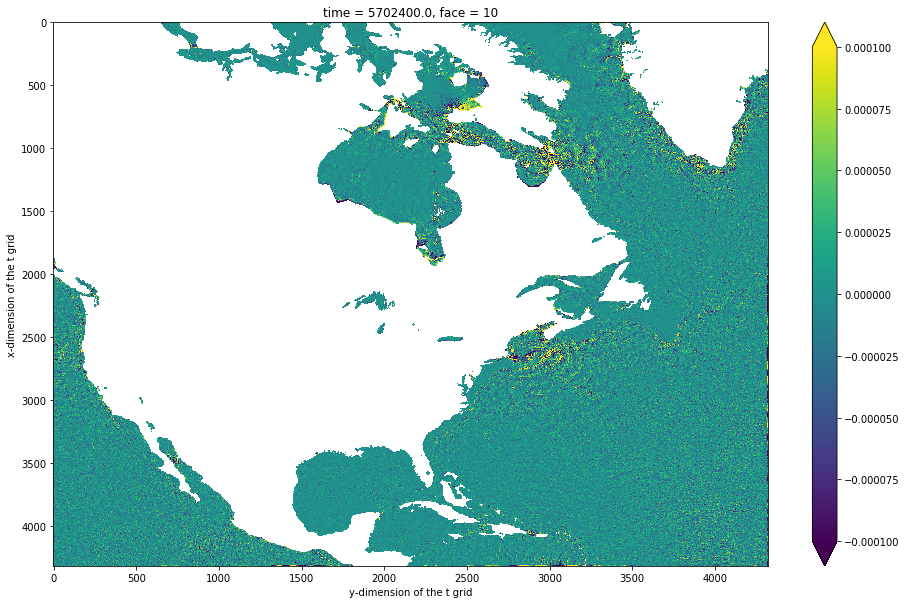

In [61]:
fig = plt.figure(figsize=(16,10))

divergence_time0_t = divergence_time0.isel(face=10).transpose()
divergence_time0_t.plot(vmin=-0.0001, vmax=0.0001, yincrease=False)

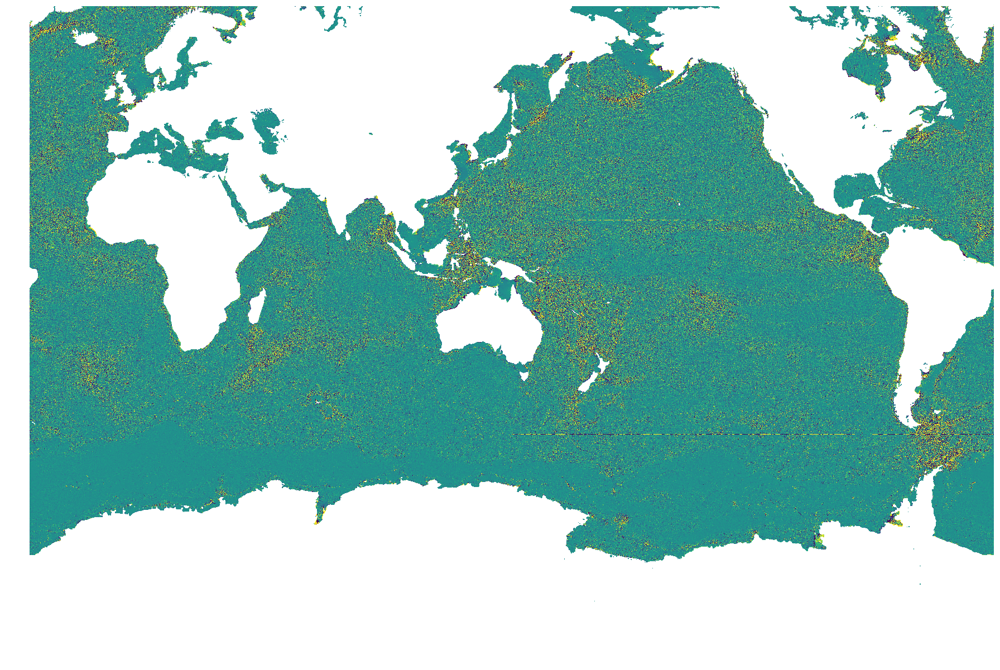

In [65]:
quick_llc_plot(divergence_time0, vmin=-0.00005, vmax=0.00005, add_colorbar=False, axis_off=True)

In [12]:
cluster.scheduler.close()

<Future finished result=None>